In [1]:
from datautil.common import path_to_save_base
from datautil.gamelog import result_parse

In [2]:
import re
def parse(logs):
    cursor = 0
    inning = (0, 0)
    pitcher_id = None 
    batter_id = None

    watch = (0,0)

    stack = []
    last_result = None
    
    results = []
    
    while cursor < len(logs):
        ln = logs[cursor]

        res_inn = re.search("(Top|Bottom) of the ([0-9]+)(st|nd|rd|th) -", ln)
        if res_inn != None:
            inning = (int(res_inn.group(2)), 0 if res_inn.group(1)=='Top' else 1)
            
            if batter_id != None:
                results.append({'result':last_result, 'batter':batter_id, 'pitcher':pitcher_id})
            batter_id = pitcher_id = None
            
            res_p = re.search("Pitching for .* : .HP <a href=\"../players/player_(\d)+.html", ln)
            if res_p != None:
                pitcher_id = int(res_p.group(1))
            
            cursor += 1
            continue

        res_p = re.search("Pitching: .HP <a href=\"../players/player_(\d+).html", ln)
        if res_p != None:
            pitcher_id = int(res_p.group(1))
            cursor += 1
            continue

        # Pinch Hitting: LHB <a href="../players/player_543.html">Morgan McCants</a>
        res_b = re.search("(Batting|Pinch Hitting): .HB <a href=\"../players/player_(\d+).html", ln)
        if res_b != None:
            if len(stack) > 0 and last_result == None:
                print(inning)
                print("".join(["*** " + a for a in stack]))
                print("^ Add this case")
            if batter_id != None:
                if pitcher_id == None:
                    print(inning)
                    print("".join(["*** " + a for a in stack]))
                    raise Exception("Look")
                results.append({'result':last_result, 'batter':batter_id, 'pitcher':pitcher_id})
            elif last_result != None and 'loc' in last_result:
                print(inning)
                print("".join(["*** " + a for a in stack]))
                raise Exception("Look")
            batter_id = int(res_b.group(2))
            #print ("- Batter", batter_id, "PH" if res_b.group(1) == "Pinch Hitting" else "")
            cursor += 1
            stack = []
            
            last_result = None
            continue


        evntList = [
            ("OUT", ["GO"], "Ground out ([^ ]*) \((.*), (.*), EV (.*) MPH\)", ["def", "gftype", "loc", "spd"]),
            ("OUT", ["GO"], "Grounds out, ([^ ]*) \((.*), (.*), EV (.*) MPH\)", ["def", "gftype", "loc", "spd"]),
            # TODO: resolve flyout
            ("OUT", ["FO"], "Fly out, ([^ ]*) *\((.*), (.*), EV (.*) MPH\)", ["def", "gftype", "loc", "spd"]),
            ("OUT", ["GO", "GIDP"], "Grounds into (double|DOUBLE) play, ([^ ]*) *\((.*), (.*), EV (.*) MPH\)", ["_", "def","gftype","loc","spd"]),
            ("OUT", ["TP"], "(Grounds|Lines) into TRIPLE play, (.*) *\((.*), (.*), EV (.*) MPH\)", ["_", "def","gftype","loc","spd"]),
            ("OUT", ["FC"], "Fielders Choice at .*, (.*) \((.*), (.*), EV (.*) MPH\)", ["def","gftype","loc","spd"]),
            ("OUT", ["FC"], "Grounds into fielders choice (.*) \((.*), (.*), EV (.*) MPH\)", ["def","gftype","loc","spd"]),
            ("FC", [], "Fielders Choice attempt at .*, Runner SAFE", []),
            ("HIT", [], "<b>(SINGLE|DOUBLE|TRIPLE)</b>  \((.*), (.*), EV (.*) MPH\)", ["hittype", "gftype","loc","spd"]),
            ("HR", [], "<b>([1-9A-Z-]*|GRAND SLAM) HOME RUN</b>  \((.*), (.*), EV (.*) MPH\)", ["hrtype", "gftype","loc","spd"]),
            ("OUT", ["SO"], "Strikes out (looking|swinging)", ["sotype"]),
            ("ERR", ["DEF"], "Reached on error, E(.) \((.*), (.*), EV (.*) MPH\)", ["def", "gftype","loc","spd"]),
            ("ERR", ["DROP"], "Reached via error on a dropped throw from (.*), E(.) \((.*), (.*), EV (.*) MPH\)", ["def", "culprit", "gftype","loc","spd"]),
            ("ERR", ["CI"], "Reaches on Catchers interference", []),
            ("HBP", [], "Hit by Pitch", []),
            ("BB", [], "Base on Balls", []),
            ("BB", [], "3-[012]: Ball", []),
            ("IBB", [], "Intentional Walk", []),
            ("HIT", ["ERR"], "Single, Error in .*, E(.), batter to second base \((.*), (.*), EV (.*) MPH\)", ["culprit","gftype","loc","spd" ]),
            ("OUT", ["HIT", "RUNDOWN"], "SINGLE, rundown, out", []),
            ("HIT", [], "SINGLE, rundown, safe", []),
            ("HIT", ["OUT"], "SINGLE, but batter called out on appeal for missing .* base!", []),
            # Bunts
            ("OUT", ["FO", "BUNTFAIL"], "Bunt - Flyout to ([^ ]*)", ["loc"]),
            ("OUT", ["SO", "BUNTFAIL"], "(Bunted foul|Bunt missed), Strikeout!", ["reason"]),
            ("OUT", ["SAC"], "Sac Bunt to ([^ ]*)", ["loc"]),
            ("OUT", ["GO", "BUNTFAIL", "DP"], "Sac Bunt - play at second, runner OUT -> throw to first, DP!", []),
            ("HIT", ["BUNT"], "Bunt for hit to ([^ ]*) - play at first, batter safe!", ["loc"]),
            ("HIT", ["BUNT"], "Sac Bunt by (.*) - play at .*, runner safe!", ["loc"]),
            ("OUT", ["GO", "BUNTFAIL"], "Bunt for hit to (.*) - play at first, batter OUT! (.*)", ["loc", "def"]),
            ("HIT", ["BUNT"], "<b>Squeeze Bunt to (.*) - play .*, runner scores, batter safe!</b>", ["loc"]),
            ("OUT", ["SAC"], "Squeeze Bunt to (.*) - play at first, runner scores, batter OUT! (.*)", ["loc", "def"]),
            ("FC", ["BUNT"], "Squeeze Bunt to (.*) - play .*, runner OUT, batter safe! .*", ["loc", "def"]),
            # not PA result
            ("RUNNEROUT", ["PK"], "Pickoff Throw to (First|Second|Third) - Out", ["base"]),
            ("RUNNEROUT", ["PK"], "Pickoff Play to (.*), Runner tries for .*, OUT after rundown.", ["base"]),
            ("RUNNEROUT", ["PK"], "Pickoff Throw by Catcher to (First|Second|Third) - Out!", ["base"]),
            ("RUNNEROUT", ["CS"], "player_(\d+)\.html.*is caught stealing ([^ ]*) (base [^ ]*)", ["runner", "base", "def"]),
            ("RUNNEROUT", ["CS"], "<b>Steal of home, .*player_(\d+)\.html.* is out</b>", ["runner"])
        ]

        for ev, basetags, regx, info in evntList:
            res = re.search(regx, ln)
            if res != None:
                try:
                    infomap = dict(zip(info, res.groups()))
                except Exception as e:
                    print (ev)
                    print (info)
                    print (*res.groups())
                    raise e

                tags = basetags
                if "DP" in ln and "DP" not in tags:
                    tags.append("DP")
                if "FO" in tags:
                    if "Runner from 3rd tags up, SCORES" in logs[cursor+1]:
                        tags.append("SF")
                #print ("-- {} {} {}".format(ev, tags, infomap))
                last_result = (ev, tags, infomap)

                if 'loc' in infomap and infomap['loc'] == 'Line Drive':
                    print (ln)
                    raise Exception("invalid loc")
        stack.append(ln)

        cursor += 1
    
    return results


In [3]:
import os, time
def_res = {}
logs_with_loc = []
import json

if os.path.exists('cache.json') == False:
    # use cache (it runs 30s ~ 60s per each game)
    for test in range(8001, 8015):
        save = 'test_' + str(test)

        dn = path_to_save_base(save) + "/news/txt/leagues/"

        files = os.listdir(dn)
        start = time.time()
        for fn in files:

            try:
                for s in parse(open(dn + fn).readlines()):
                    ev = s['result']
                    if ev is None:
                        continue

                    if "loc" in ev[2]:
                        logs_with_loc.append({**s, 'game':test})
                        
            except Exception as e:
                print(save, fn)
                raise e
        print(time.time() - start)
    
    with open('cache.json','w') as f:
        json.dump(logs_with_loc, f)

In [4]:
#with open('cache.json','w') as f:
#    json.dump(logs_with_loc, f)

In [5]:
# or load
import json
with open('cache.json') as f:
    logs_with_loc = json.load(f)

In [6]:
infield = 0
for log in logs_with_loc:
    #print (log)
    loc = log['result'][2]['loc']
    if loc[0] in '123456':
        infield += 1

infield

656855

In [7]:
def_rev = {'1B':'3', '2B':'4', '3B':'5', 'SS':'6', 'P':'1', 'C':'2', 'LF':'7', 'CF':'8', 'RF':'9'}
def agg(logs):
    aggmap = {}
    for log in logs:
        loc = log['result'][2]['loc']
        
        if loc[-1] == '!':
            loc = loc[:-1]
            
        frac = aggmap.get(loc, {})
        tags = log['result'][1] + [log['result'][0]]
        frac['TOTAL']=frac.get('TOTAL',0)+1
        if 'HIT' in tags:
            frac['HIT'] = frac.get('HIT', 0) + 1
        if 'OUT' in tags:
            frac['OUT'] = frac.get('OUT', 0) + 1
        if log['result'][2].get('def', None) != None:
            defender = log['result'][2]['def']
            if defender[0] == 'F' or defender[0] == 'U': # F=flyout, U=unassisted put out
                defender = defender[1:]
            if len(defender) > 1 and defender[1] == '-':
                defender = defender[0]
            if defender in def_rev:
                defender = def_rev[defender]
            
            frac[defender] = frac.get(defender, 0) + 1
        aggmap[loc] = frac
    return aggmap

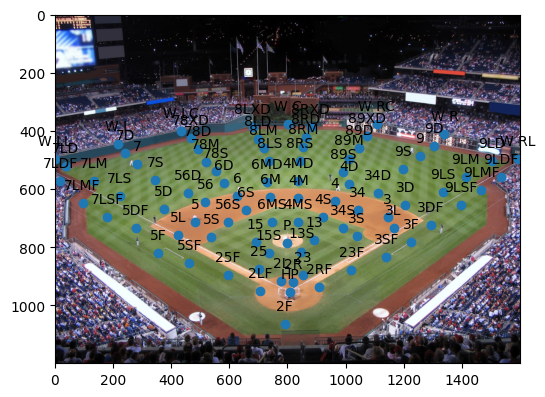

In [8]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np

im = Image.open('images/default_grass.jpg')
fig, ax = plt.subplots(figsize=(6,6))
ax.imshow(im)

coord_data = np.loadtxt('stadium_coord.csv', delimiter=',', skiprows=1, dtype=str)

# Extract columns
labels = coord_data[:, 0]
x_coords = coord_data[:, 1].astype(float) * 2.5
y_coords = coord_data[:, 2].astype(float) * 2.5

# Plotting
plt.scatter(x_coords, y_coords)
for i in range(len(labels)):
    plt.annotate(labels[i], (x_coords[i], y_coords[i]), textcoords="offset points", xytext=(0,10), ha='center', color='black')


plt.show()

In [9]:
import pandas as pd
import matplotlib

def show_bat_direction(data, title):
    total = sum([v['TOTAL'] for k,v in data.items()])
    maxv =  max([v['TOTAL'] for k,v in data.items()])
    
    im = Image.open('images/default_grass.jpg')
    fig, ax = plt.subplots(figsize=(12,12))
    ax.imshow(im)

    coord_data = pd.read_csv('stadium_coord.csv')

    loc_to_coord = coord_data.set_index('Location').T.to_dict('list')
    cmap = matplotlib.colormaps['RdYlGn']

    for loc, (x,y) in loc_to_coord.items():
        ax.text(x*2.5, y*2.5, loc, horizontalalignment='center')

    for loc, data in data.items():
        if loc not in loc_to_coord:
            #print (loc)
            continue

        x,y = loc_to_coord[loc]
        height =  data['TOTAL'] / maxv * 200
        color = cmap(data['TOTAL'] / maxv)  # Assign color based on height
        ax.add_patch(plt.Rectangle((x * 2.5 - 12.5, y * 2.5 - height), 25, height, color=color, alpha=0.7))

        if data['TOTAL']/total > 0.005:
            ax.text(x*2.5, y*2.5 + 5, '({:.1f}%)'.format(data['TOTAL']/total*100), horizontalalignment='center', verticalalignment='top', color='black', size='x-small')

    plt.axis('off')
    plt.title(title)
    plt.show()

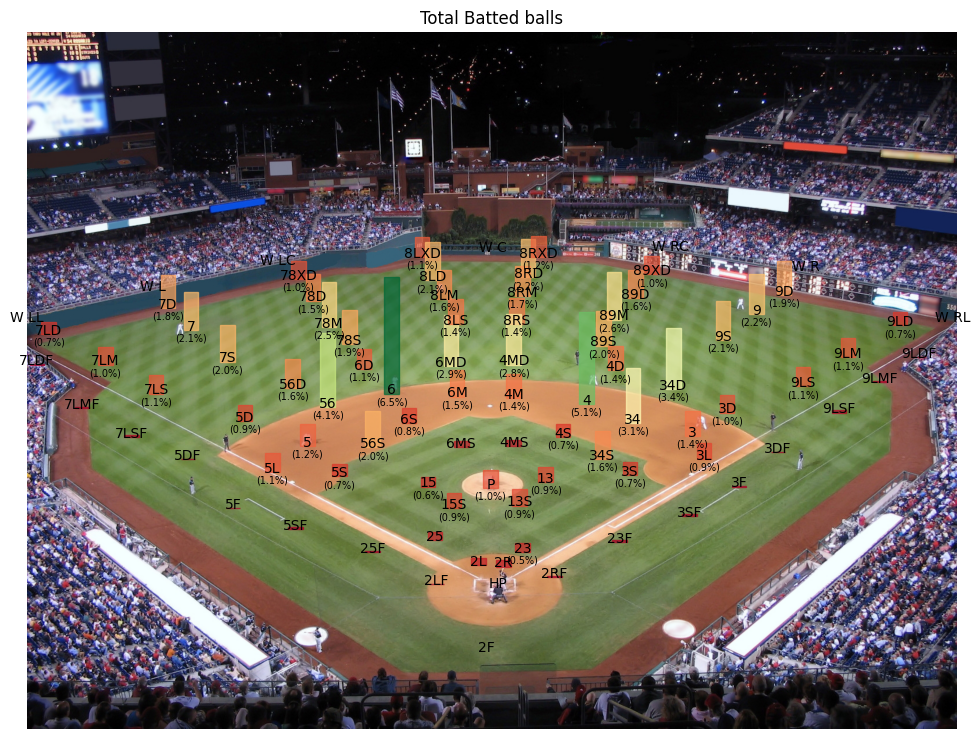

In [10]:
agg_data = agg(logs_with_loc)
show_bat_direction(agg_data, 'Total Batted balls')

In [11]:
logs_with_loc[0]

{'result': ['HIT',
  [],
  {'hittype': 'SINGLE', 'gftype': 'Groundball', 'loc': '3D', 'spd': '97.5'}],
 'batter': 1498,
 'pitcher': 146,
 'game': 8001}

In [12]:
locs = set()
for log in logs_with_loc:
    locs.add(log['result'][2]['loc'])
print(locs)

{'9LS', '3D', '6M', '7LDF', '8LM', '56D', '2LF', '3', 'S7', '89XD', '34S', '5S', '4S', '78D', '56', '8LS', 'S1', '9LDF', 'S5', '3S', 'P', '6D', '34D', '78XD', '7D', '13S', '78S', '5SF', '8RM', '25', '89S', '25!', '23F', '5F', '8RXD', '34', 'S3', 'S6', '3SF', 'S4', '23', '89M', '7LM', '3L', '15!', '8RS', '89D', '13S!', '5', '7LMF', '8LXD', '8RD', '23!', '13', '25F', '7', '4D', '9D', '2L', '15S!', '5L', '4', '8LD', '3S!', '6', '7LSF', '7S', '4MS', '15', '5S!', '6S', '9S', 'P!', '6MS', '6MD', '2R!', 'S8', '4MD', '9', '2L!', '9LSF', '9LD', '78M', '9LM', '13!', '2RF', 'S2', '56S', '2R', '5DF', '7LD', '3DF', '3F', '7LS', '15S', '4M', '5D', '9LMF'}


In [13]:
from datautil.stat_loader import load_player_rating_map
player_data_map_cache = {}
def get_batter_hand(save_name, batter_id, pitcher_id): # pitcher id matters if switch hitter
    if save_name not in player_data_map_cache:
        player_data_map_cache[save_name] = load_player_rating_map(save_name)
    try:
        bat_h = player_data_map_cache[save_name][batter_id]['bats']
        if bat_h == 3:
            bat_h = 3 - player_data_map_cache[save_name][pitcher_id]['throws']
        return 'R' if bat_h == 1 else 'L'
    except:
        return '?' # Retired before game end? uncertain

def get_gb_type(save_name, batter_id):
    # batting_ratings_misc_gb_hitter_type
    if save_name not in player_data_map_cache:
        player_data_map_cache[save_name] = load_player_rating_map(save_name)
    try:
        return player_data_map_cache[save_name][batter_id]['batting_ratings_misc_gb_hitter_type']
    except:
        return -1 # Retired before game end? uncertain
    
def get_pitcher_gf_type(save_name, pitcher_id):
    if save_name not in player_data_map_cache:
        player_data_map_cache[save_name] = load_player_rating_map(save_name)
    try:
        return player_data_map_cache[save_name][pitcher_id]['pitching_ratings_misc_ground_fly']
    except:
        return -1 # Retired before game end? uncertain
    
get_batter_hand('test_8001', 1498, 146)
        

'R'

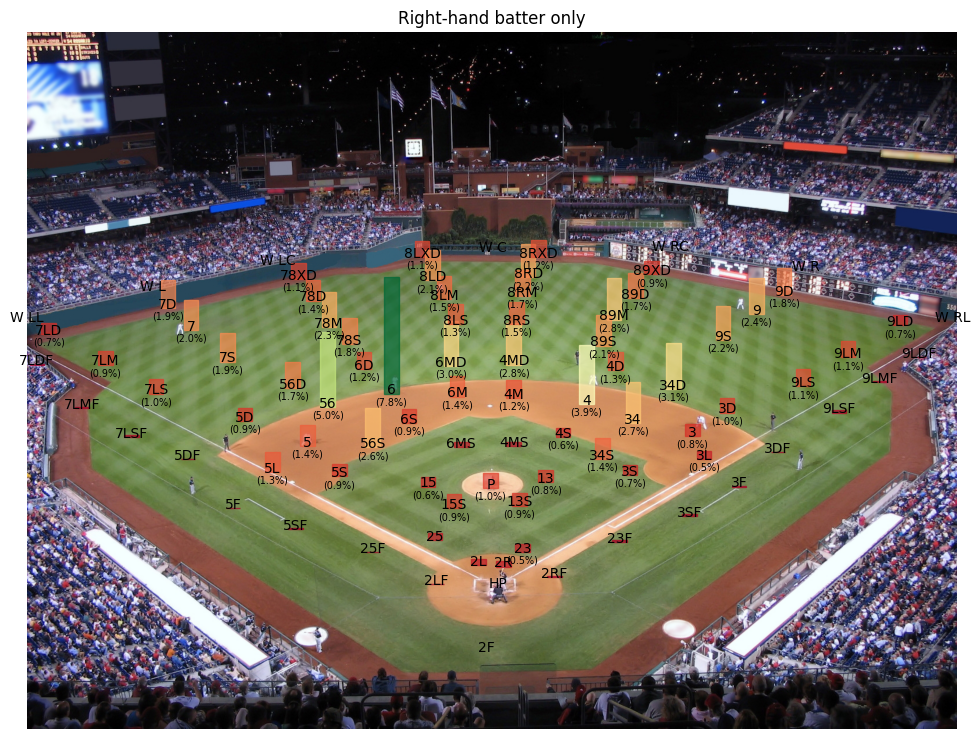

In [14]:
ff = lambda log: get_batter_hand("test_{}".format(log['game']), log['batter'], log['pitcher'])=='R'
show_bat_direction(agg(filter(ff, logs_with_loc)), 'Right-hand batter only')

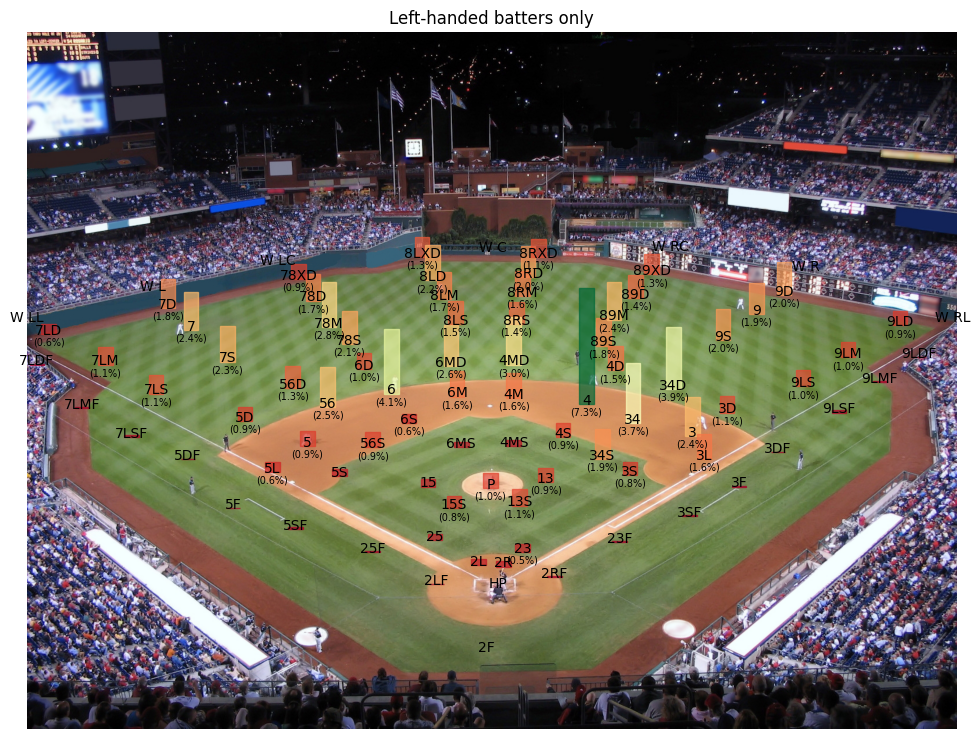

In [15]:
ff = lambda log: get_batter_hand("test_{}".format(log['game']), log['batter'], log['pitcher'])=='L'
show_bat_direction(agg(filter(ff, logs_with_loc)), "Left-handed batters only")

In [16]:
def show_bat_direction_2x2(data_list, title):
    fig, axs = plt.subplots(2,2,figsize=(16,16))
    fig.tight_layout()
    
    for i in range(4):
        data = data_list[i]
        ax = axs[i//2][i%2]
        
        total = sum([v['TOTAL'] for k,v in data.items()])
        maxv =  max([v['TOTAL'] for k,v in data.items()])

        im = Image.open('images/default_grass.jpg')
        
        ax.imshow(im)

        coord_data = pd.read_csv('stadium_coord.csv')

        loc_to_coord = coord_data.set_index('Location').T.to_dict('list')
        cmap = matplotlib.colormaps['RdYlGn']

        for loc, (x,y) in loc_to_coord.items():
            ax.text(x*2.5, y*2.5, loc, horizontalalignment='center', size='x-small')

        for loc, data in data.items():
            if loc not in loc_to_coord:
                #print (loc)
                continue

            x,y = loc_to_coord[loc]
            height =  data['TOTAL'] / maxv * 200
            color = cmap(data['TOTAL'] / maxv)  # Assign color based on height
            ax.add_patch(plt.Rectangle((x * 2.5 - 12.5, y * 2.5 - height), 25, height, color=color, alpha=0.7))

            if data['TOTAL']/total > 0.005:
                ax.text(x*2.5, y*2.5 + 5, '({:.1f}%)'.format(data['TOTAL']/total*100), horizontalalignment='center', verticalalignment='top', color='black', size='xx-small')

        ax.axis('off')
        
    plt.show()

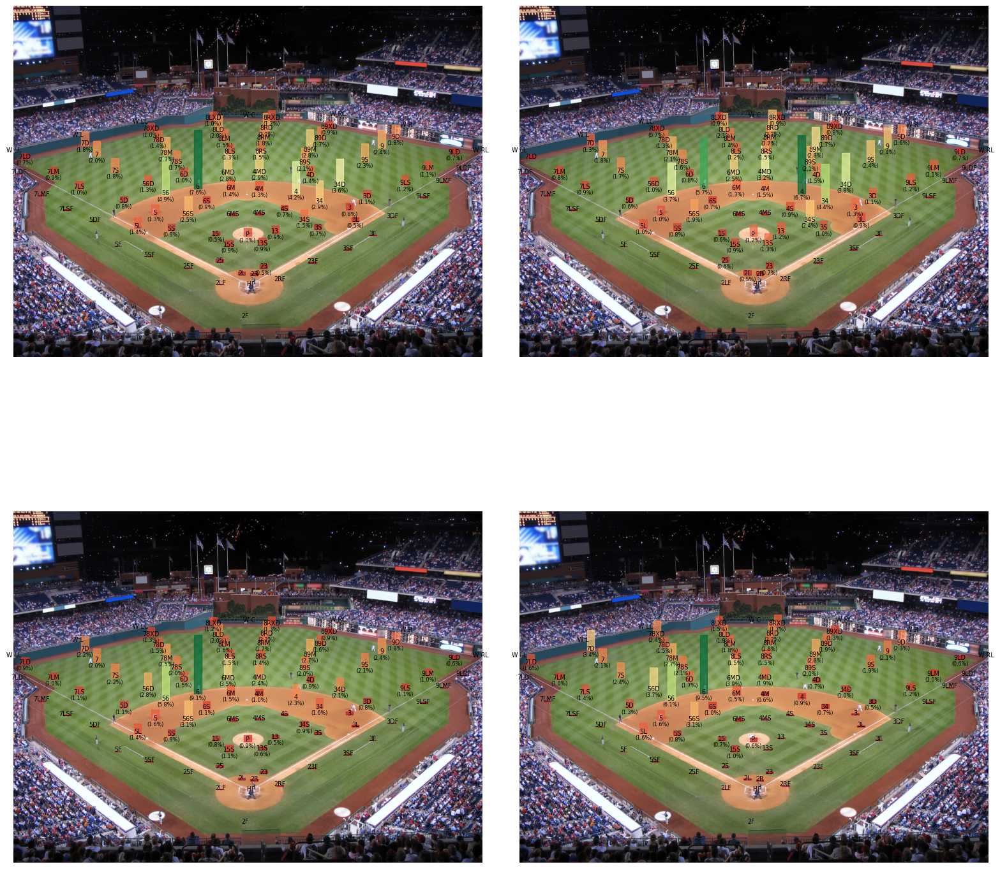

In [17]:
ff = lambda log: get_batter_hand("test_{}".format(log['game']), log['batter'], log['pitcher'])=='R'
rhb_log = list(filter(ff, logs_with_loc))
sublist = [[],[],[],[]]

for log in rhb_log:
    gbtype = get_gb_type('test_{}'.format(log['game']), log['batter'])
    sublist[gbtype] += [log]

show_bat_direction_2x2(list(map(agg ,sublist)), "RHB")

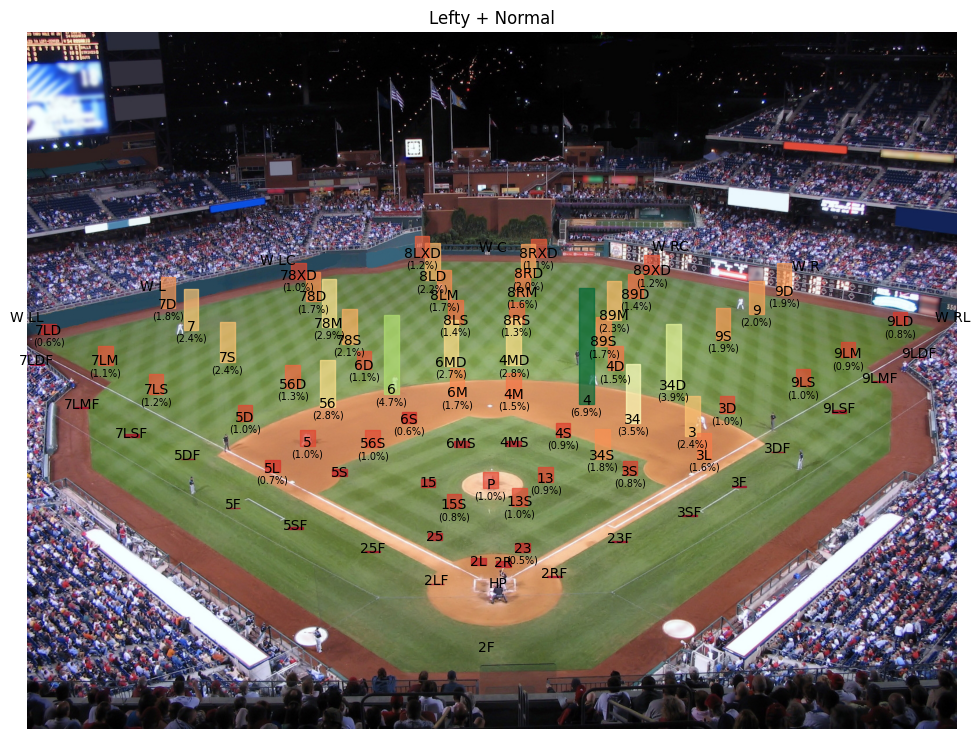

In [18]:
ff = lambda log: get_gb_type('test_{}'.format(log['game']), log['batter']) == 0 and get_batter_hand("test_{}".format(log['game']), log['batter'], log['pitcher'])=='L'
show_bat_direction(agg(filter(ff, logs_with_loc)), 'Lefty + Normal')

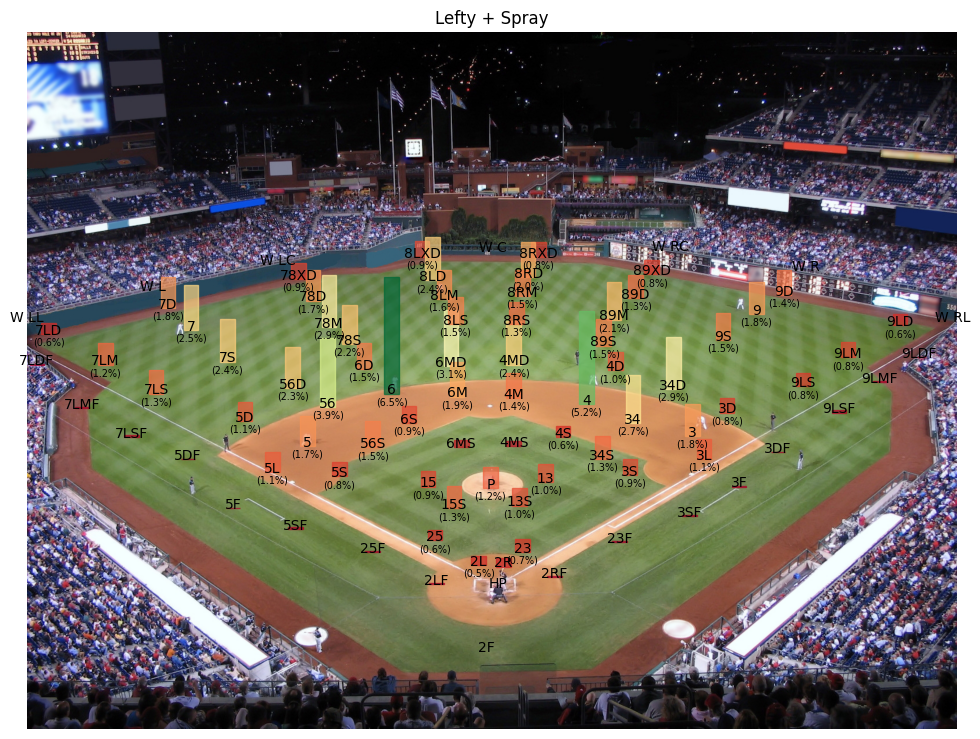

In [19]:
ff = lambda log: get_gb_type('test_{}'.format(log['game']), log['batter']) == 1 and get_batter_hand("test_{}".format(log['game']), log['batter'], log['pitcher'])=='L'
show_bat_direction(agg(filter(ff, logs_with_loc)), 'Lefty + Spray')

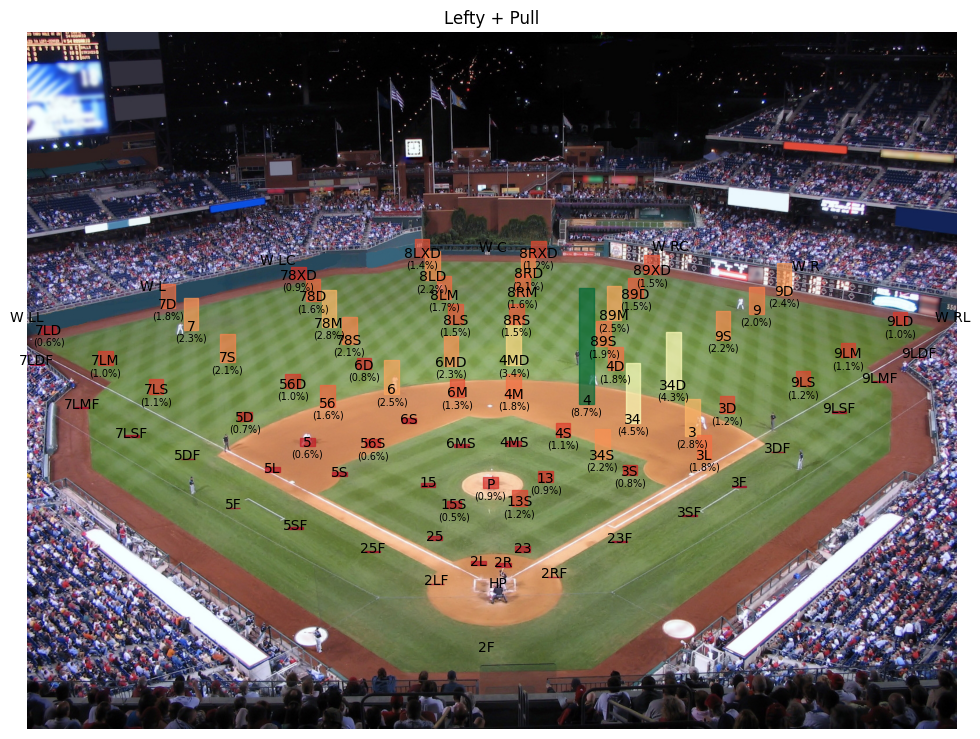

In [20]:
ff = lambda log: get_gb_type('test_{}'.format(log['game']), log['batter']) == 2 and get_batter_hand("test_{}".format(log['game']), log['batter'], log['pitcher'])=='L'
show_bat_direction(agg(filter(ff, logs_with_loc)), 'Lefty + Pull')

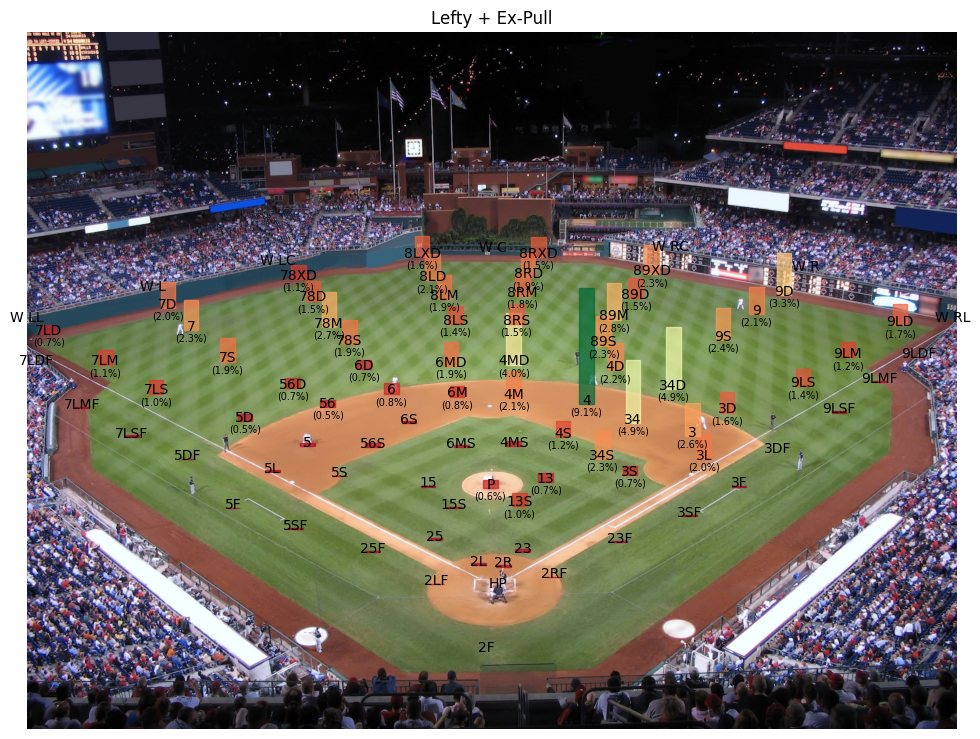

In [21]:
ff = lambda log: get_gb_type('test_{}'.format(log['game']), log['batter']) == 3 and get_batter_hand("test_{}".format(log['game']), log['batter'], log['pitcher'])=='L'
show_bat_direction(agg(filter(ff, logs_with_loc)), 'Lefty + Ex-Pull')

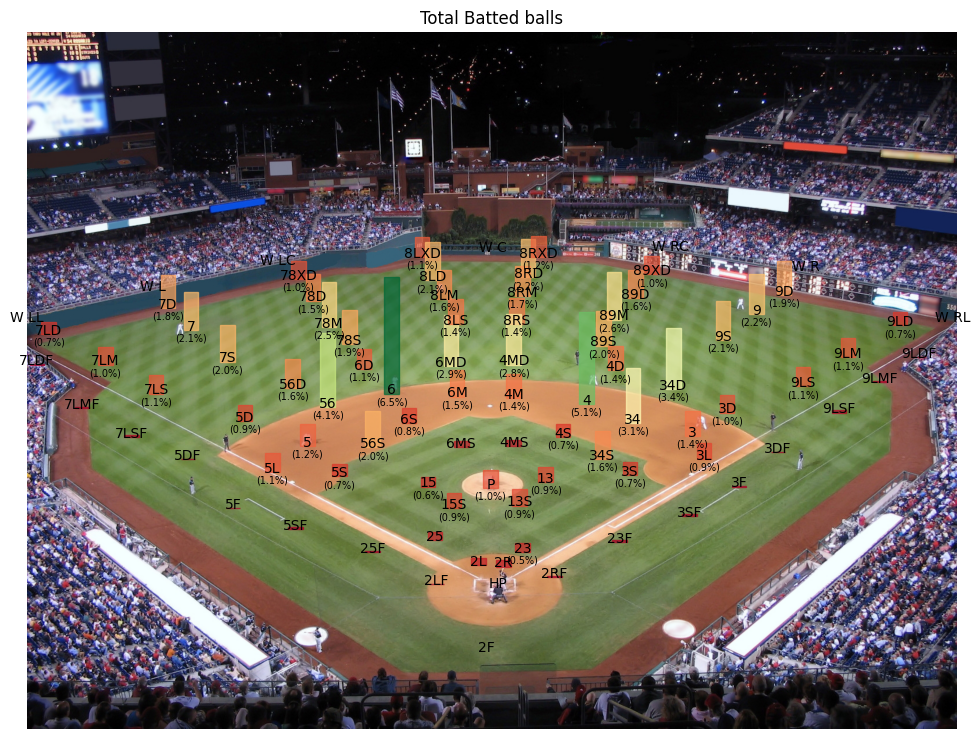

In [22]:
show_bat_direction(agg_data, 'Total Batted balls')

In [27]:
out_agg = agg([log for log in logs_with_loc if log['result'][0]=='OUT' or 'OUT' in log['result'][1]])

each_pos_out_contrib = {}

for pos in range(1,11):
    dx = []
    for loc, loc_data in out_agg.items():
        if str(pos) in loc_data:
            ss = sum([loc_data.get(str(p),0) for p in range(1,11)])
            dx.append((loc, loc_data[str(pos)] / ss))
    each_pos_out_contrib[pos] = dx
each_pos_out_contrib

{1: [('23', 0.31798966651009863),
  ('15S', 0.6711051930758988),
  ('34S', 0.2378465970471732),
  ('15', 0.36899365367180414),
  ('13S', 0.830614973262032),
  ('13', 0.3723855713852683),
  ('P', 0.5429864253393665),
  ('25', 0.32464825429911415)],
 2: [('15S', 0.3096611924840953),
  ('2R', 1.0),
  ('2L', 1.0),
  ('13S', 0.15762032085561498),
  ('5SF', 0.16373626373626374),
  ('3SF', 0.16827997021593447),
  ('23F', 0.5250521920668059),
  ('25F', 0.5171849427168577),
  ('2LF', 1.0),
  ('2RF', 1.0)],
 3: [('23', 0.5584781587599812),
  ('34', 0.60105053317723),
  ('4S', 0.0009693948206619581),
  ('4', 0.0013136889716642277),
  ('3', 0.9923795476892822),
  ('34S', 0.6418197095186652),
  ('34D', 0.06831872946330778),
  ('13S', 0.00013368983957219252),
  ('13', 0.39784783267656865),
  ('3L', 0.9994258647911584),
  ('3S', 0.9539559014267186),
  ('3SF', 0.8317200297840656),
  ('23F', 0.47494780793319413),
  ('3F', 0.9985052316890882),
  ('3D', 0.6497005988023952),
  ('3DF', 0.2988505747126437)]

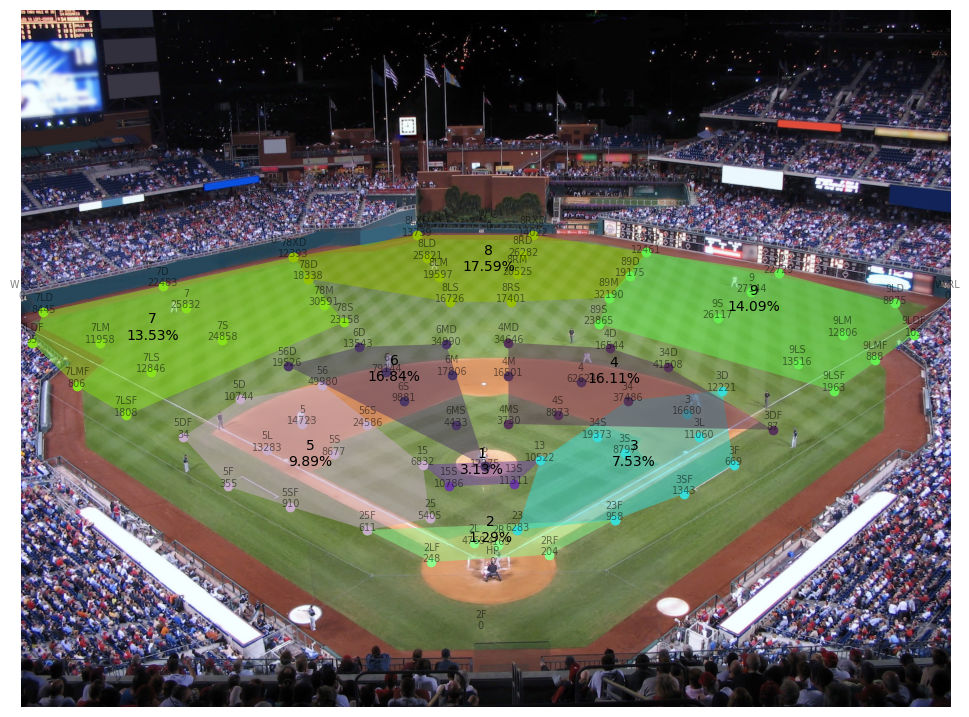

In [49]:
from scipy.spatial import ConvexHull


def render_def_area_with_contrib(interested_batted_balls):
    all_interested_batted_ball = sum([data['TOTAL'] for loc,data in interested_batted_balls.items()])
    im = Image.open('images/default_grass.jpg')
    fig, ax = plt.subplots(figsize=(12,12))
    ax.imshow(im)

    coord_data = pd.read_csv('stadium_coord.csv')

    loc_to_coord = coord_data.set_index('Location').T.to_dict('list')

    for loc, (x,y) in loc_to_coord.items():
        ax.text(x*2.5, y*2.5, loc + "\n" + str(interested_batted_balls.get(loc, {'TOTAL':0})['TOTAL']), horizontalalignment='center', size='x-small', alpha=0.5)

    ax.axis('off')

    for position, data in each_pos_out_contrib.items():
        if len(data) == 0:
            continue
        data_over_threshold = [(*loc_to_coord[loc], cont) for loc, cont in data if loc[0] != 'S' and cont>0.33] # TODO: what's S2, S3?
        clr = np.random.rand(3,)
        x = [d[0]*2.5 for d in data_over_threshold]
        y = [d[1]*2.5 for d in data_over_threshold]
        ax.scatter(x, y, color=clr)

        if len(data)<3:
            continue
        # Calculate the convex hull polygon
        points = np.column_stack((x, y))
        hull = ConvexHull(points)
        polygon = plt.Polygon(points[hull.vertices], facecolor=(*clr, 0.5))
        ax.add_patch(polygon)

        # DEF contribution
        cont_pct = sum([interested_batted_balls.get(loc, {'TOTAL':0})['TOTAL'] * cont for loc, cont in data])/all_interested_batted_ball

        hull_vertices = points[hull.vertices]

        x = np.mean(hull_vertices[:, 0])
        y = np.mean(hull_vertices[:, 1])

        ax.text(x, y, "{}\n{:.2f}%".format(position, cont_pct*100), horizontalalignment='center')

    plt.show()
    
render_def_area_with_contrib(agg_data)

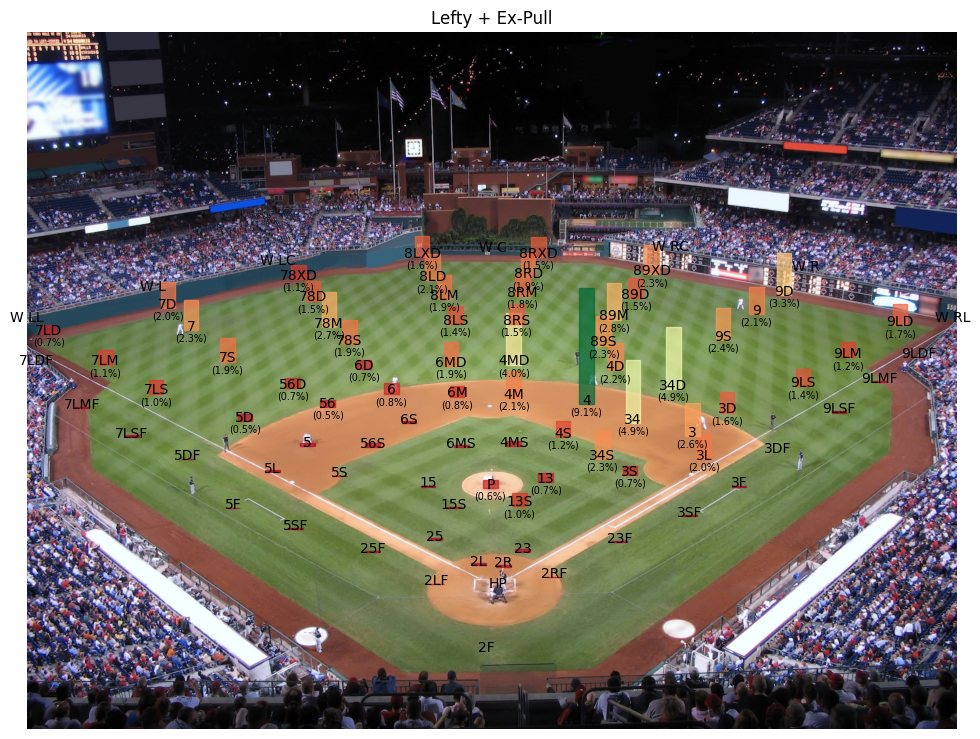

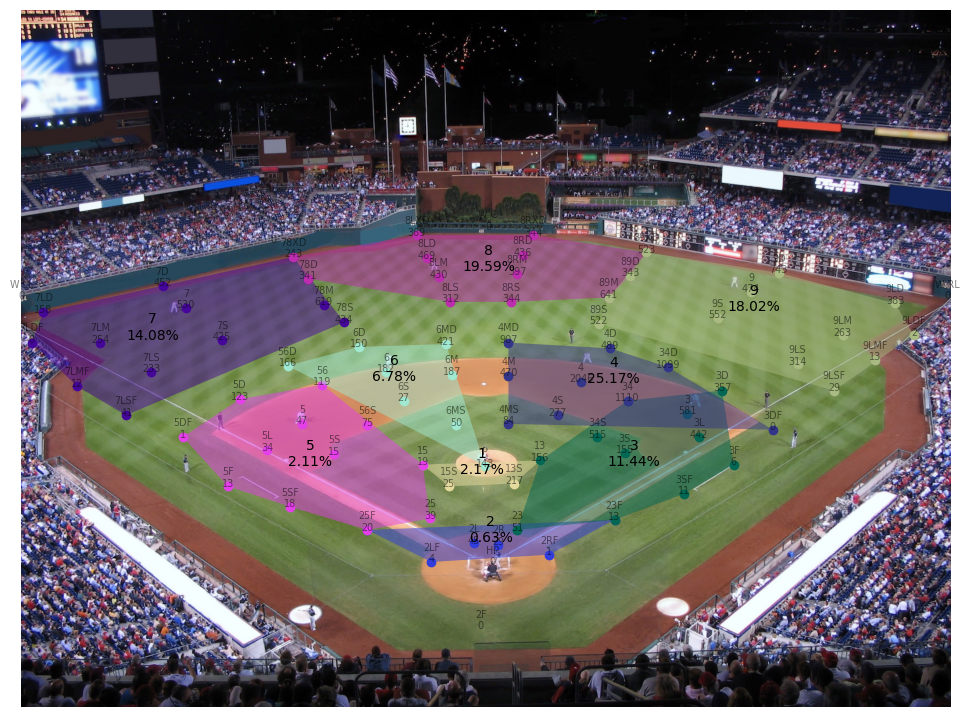

In [50]:
ff = lambda log: get_gb_type('test_{}'.format(log['game']), log['batter']) == 3 and get_batter_hand("test_{}".format(log['game']), log['batter'], log['pitcher'])=='L'
dt = agg(filter(ff, logs_with_loc))
show_bat_direction(dt, 'Lefty + Ex-Pull')
render_def_area_with_contrib(dt)

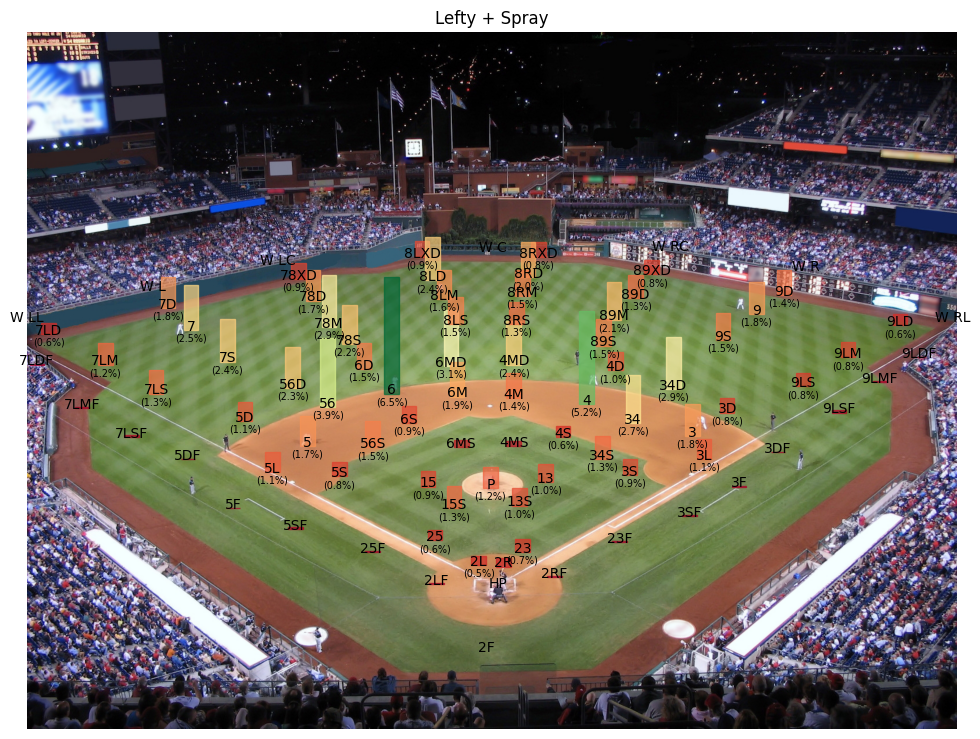

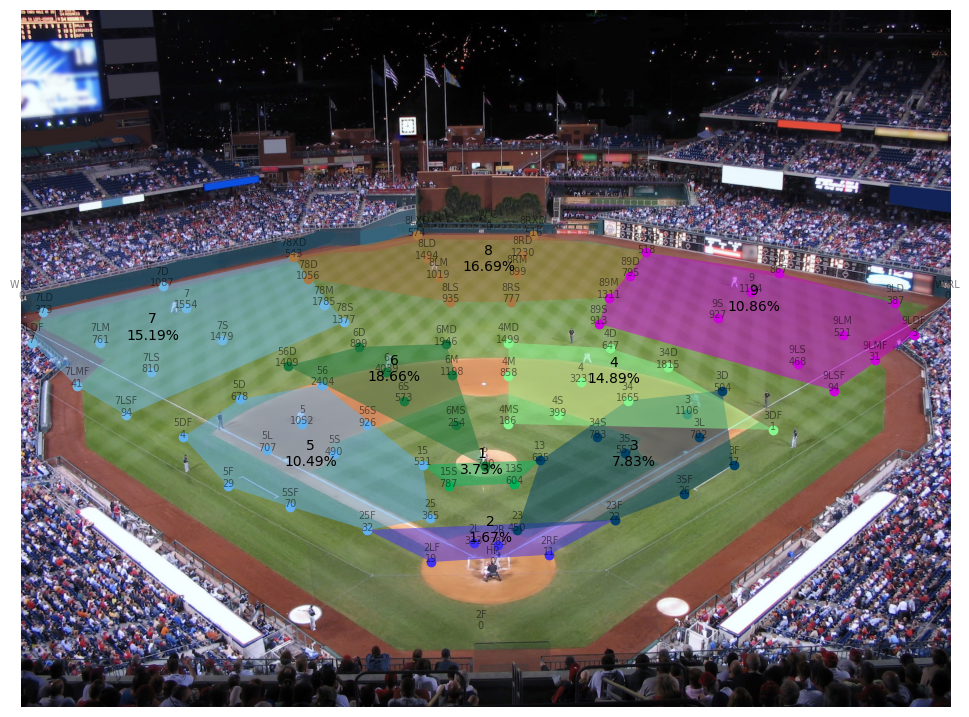

In [51]:
ff = lambda log: get_gb_type('test_{}'.format(log['game']), log['batter']) == 1 and get_batter_hand("test_{}".format(log['game']), log['batter'], log['pitcher'])=='L'
dt = agg(filter(ff, logs_with_loc))
show_bat_direction(dt, 'Lefty + Spray')
render_def_area_with_contrib(dt)

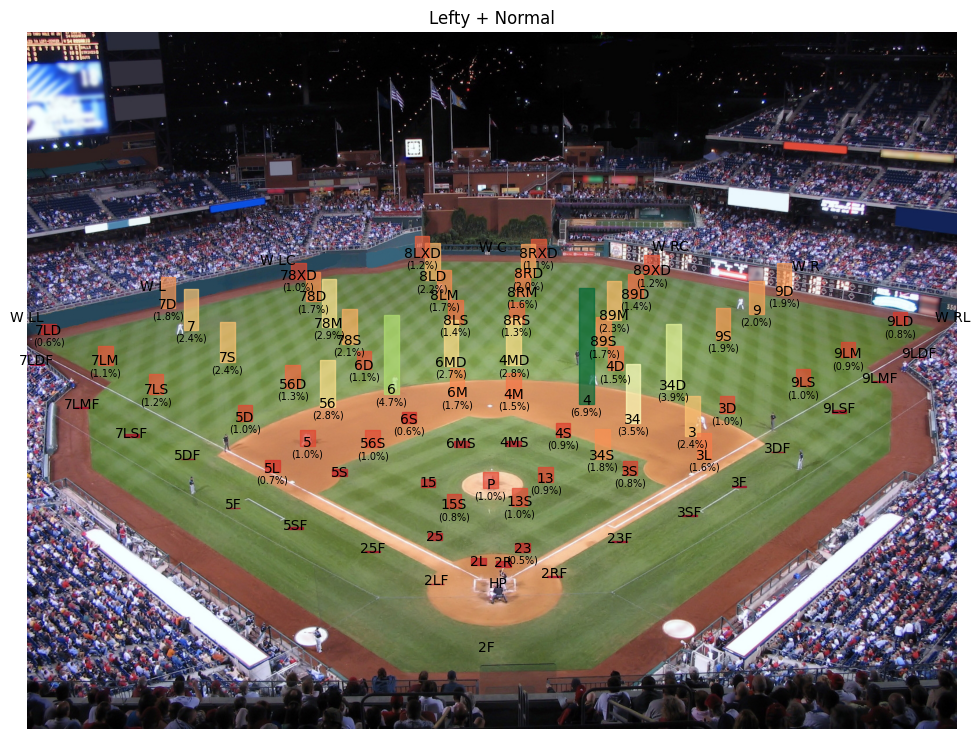

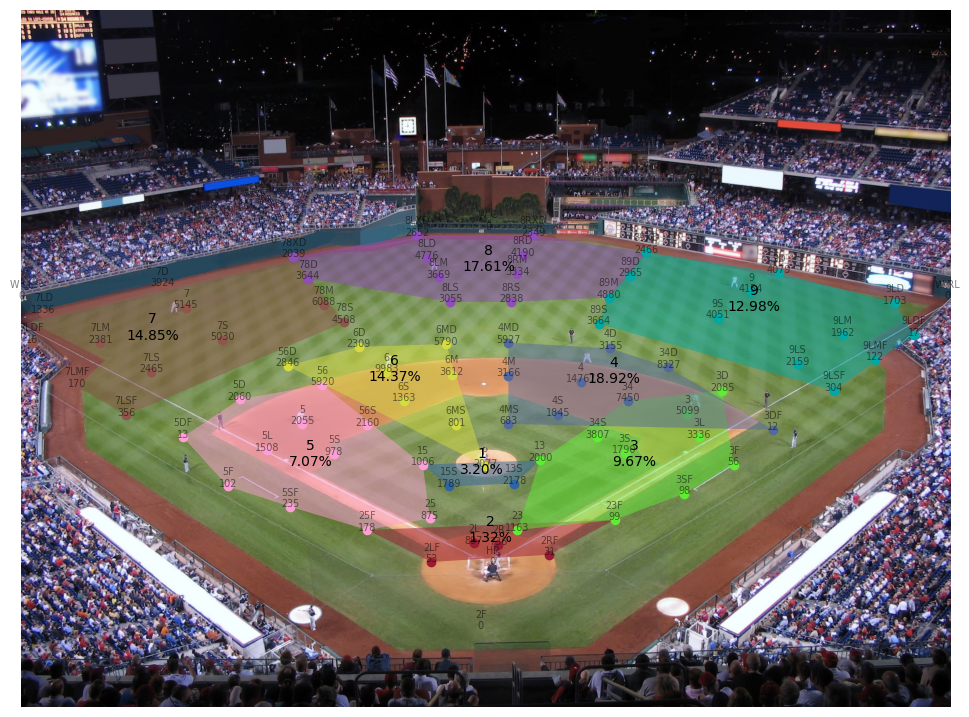

In [52]:
ff = lambda log: get_gb_type('test_{}'.format(log['game']), log['batter']) == 0 and get_batter_hand("test_{}".format(log['game']), log['batter'], log['pitcher'])=='L'
dt = agg(filter(ff, logs_with_loc))
show_bat_direction(dt, 'Lefty + Normal')
render_def_area_with_contrib(dt)

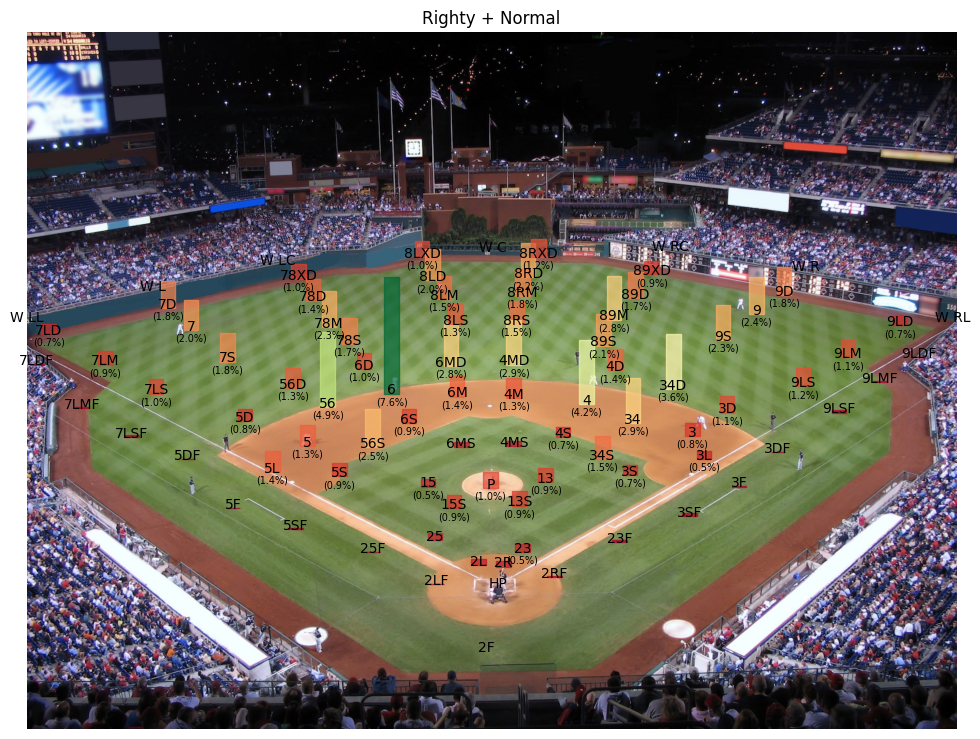

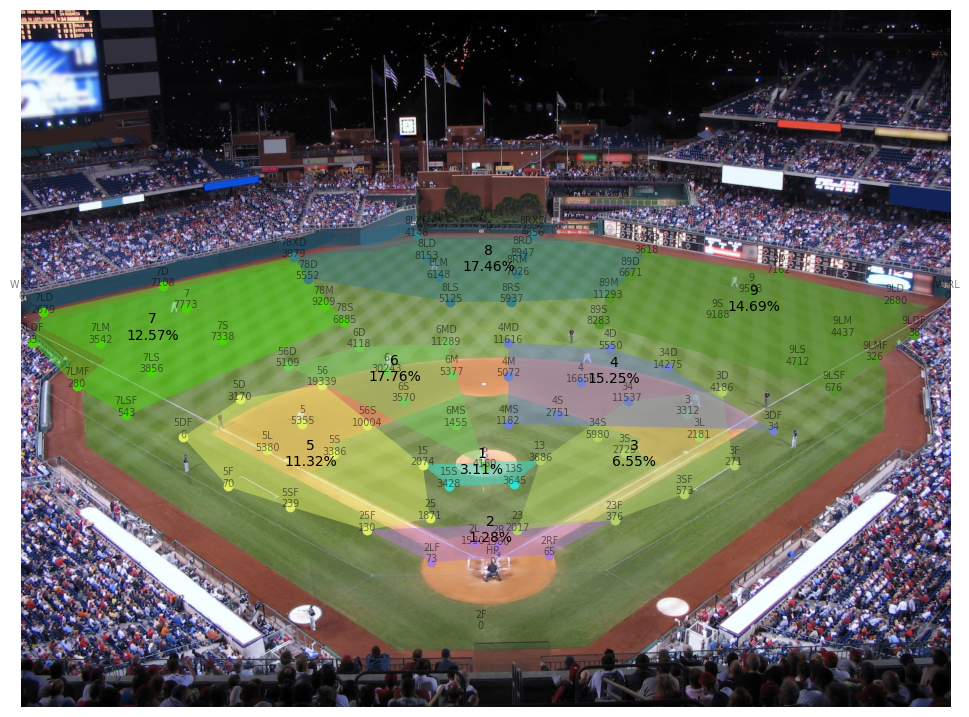

In [53]:
ff = lambda log: get_gb_type('test_{}'.format(log['game']), log['batter']) == 0 and get_batter_hand("test_{}".format(log['game']), log['batter'], log['pitcher'])=='R'
dt = agg(filter(ff, logs_with_loc))
show_bat_direction(dt, 'Righty + Normal')
render_def_area_with_contrib(dt)